<a href="https://colab.research.google.com/github/mod-ibr/ComputerVision_masterclass/blob/main/ComputerVision_masterclass/1%20-%20Face%20Detection/face_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Object detection using Haarcascade, HOG and Dlib



**Content** : 
1 -**Front Face** Detection using **Haarcascade**.
2 -**Eye Detection** using **Haarcascade**.
3 -**Front Face** Detection using **HOG** and **Dlib**.

#####Note : when using Casecade algortithm you should use (Recommended) gray scale to reduse the time because it eill take much time because Cascade algor. Leater we well learn other algorithmes to treat with  colerd Images.
 

##HaarCascade

### 1 - Front Face Detection using HaarCascade

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


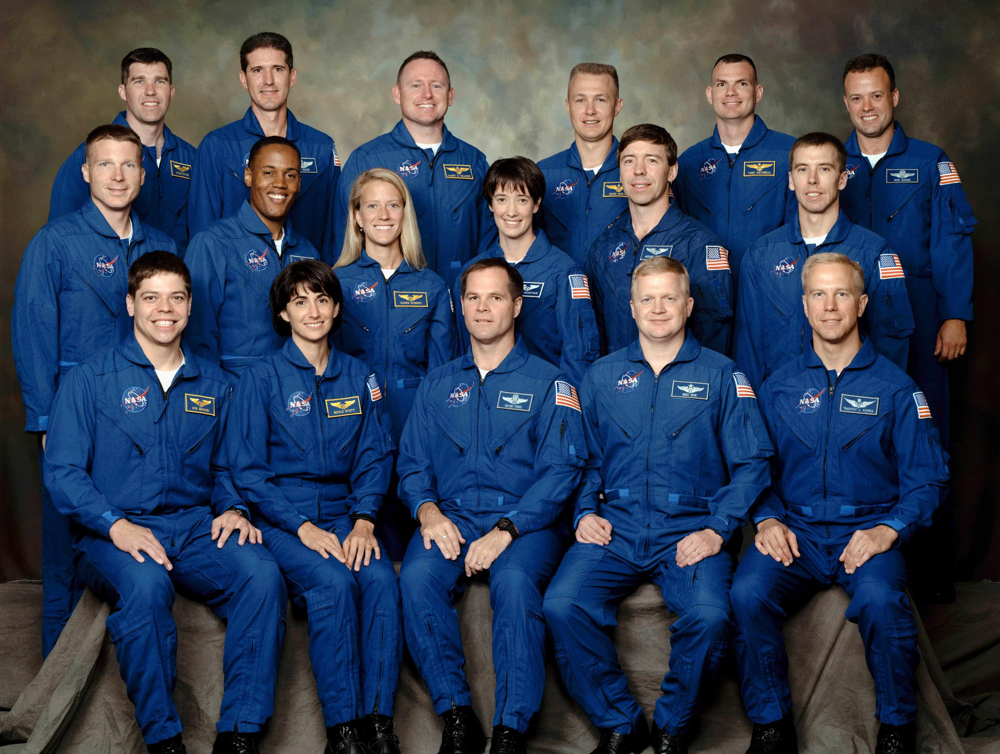

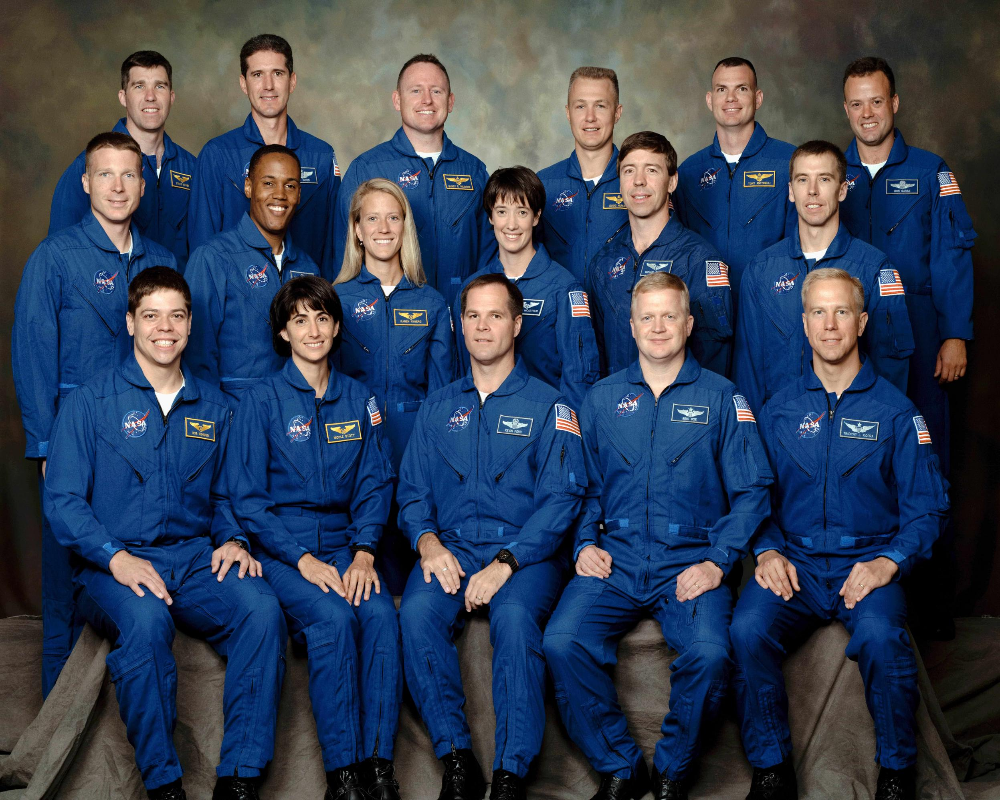

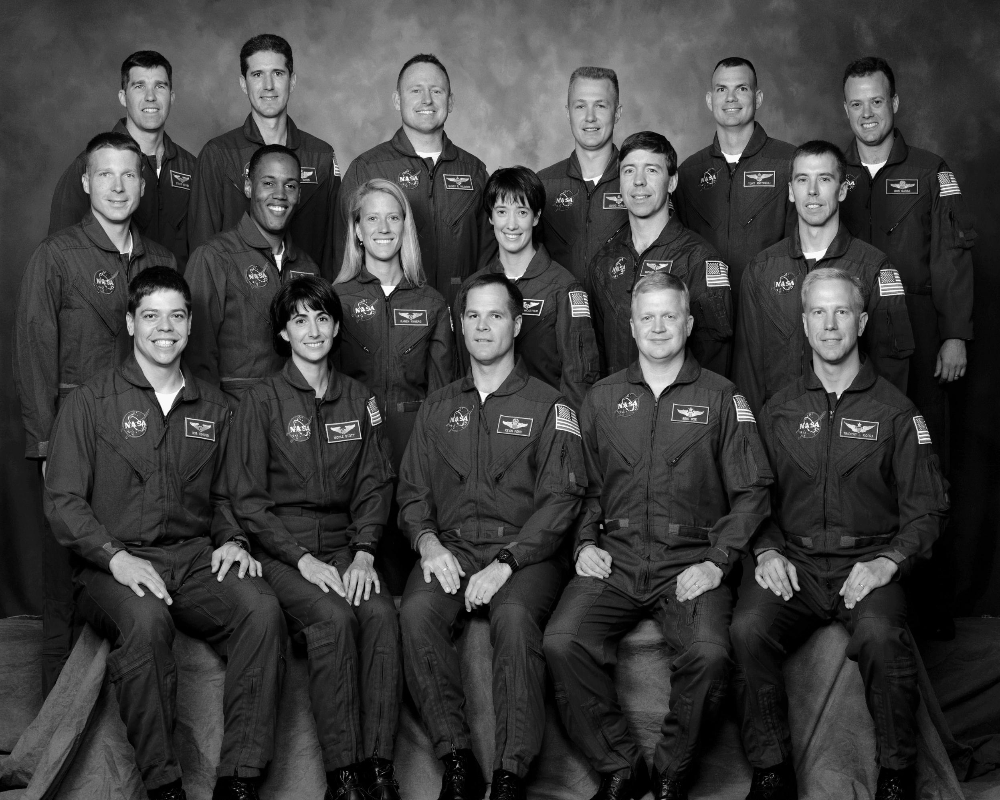

In [ ]:
# Import some Libs
import cv2
# Import Image From Drive And Show Some Detailesabout.
from google.colab import drive 
drive.mount('/content/drive')
image = cv2.imread('/content/peoble_faceDetection_example.png')
image.shape
# Note: cv2.imshow(image) 'when you use with other compiler'
from google.colab.patches import cv2_imshow
cv2_imshow(image)
# Resize The Image to reduse the time and Complexity
image = cv2.resize(image,(1000,800))
image.shape
from google.colab.patches import cv2_imshow
cv2_imshow(image)
# Convert Image To Gray Scale To Make It Easy To Apply HaarCascade Algorithem As We Obtained.
image_gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
cv2_imshow(image_gray)

The GitHub link of XML files of Haarcascade: https://github.com/opencv/opencv/tree/master/data/haarcascades

In [ ]:
faceDetector = cv2.CascadeClassifier("/content/haarcascade_frontalface_default.xml")
detections = faceDetector.detectMultiScale(image_gray,scaleFactor = 2.1)

Parameters Could Change your Accuracy:
1 - The size of Image.
2 - Hyper parameters of your Detection Object " FaceDetector.detectMultiScale(...) " Like : A - **scaleFactor** it should be greater than Double number  1.0,small tip could help you is that you should start your test with shourt addition like 1.01 and so on. B - **minNeighbors** you can make it larg Integer number like 5 and reduse it by trial and error.

In [ ]:
#detections
len(detections)

17

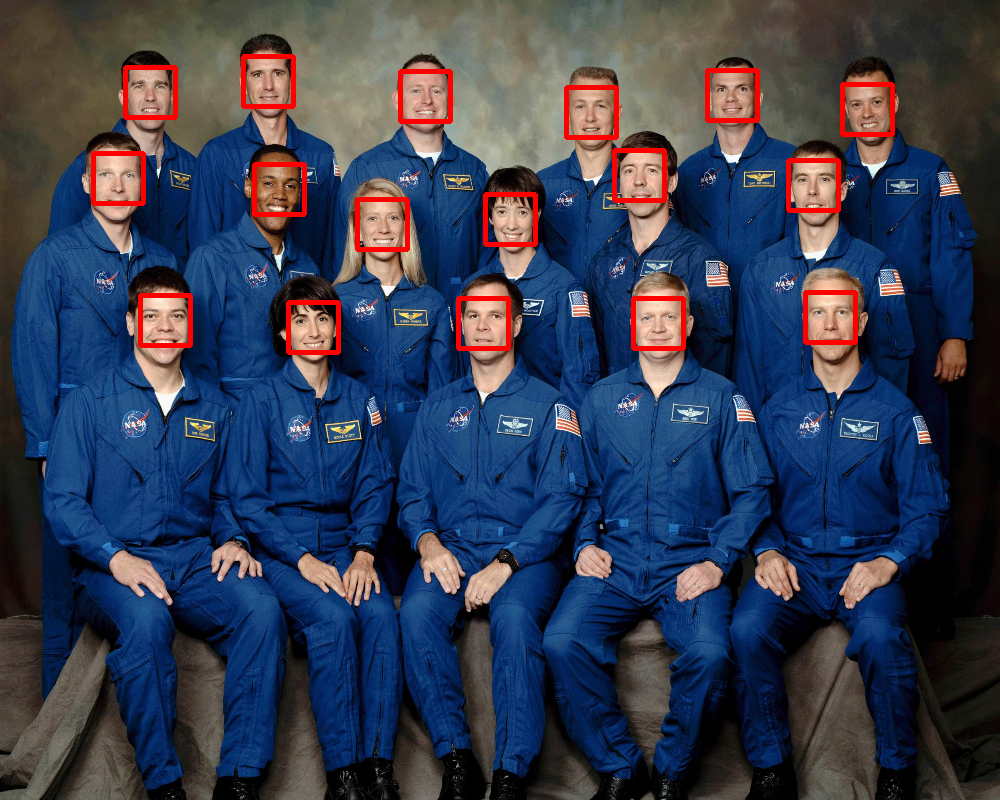

In [ ]:
tempImageForFace = image.copy()
for (x,y,w,h) in detections:
  #print(x,y,w,h)
  cv2.rectangle(tempImageForFace,(x,y),(x+w,y+h),(0,0,255),4)
cv2_imshow(tempImageForFace)

###2 - Eye Detection Using HaarCascade 

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


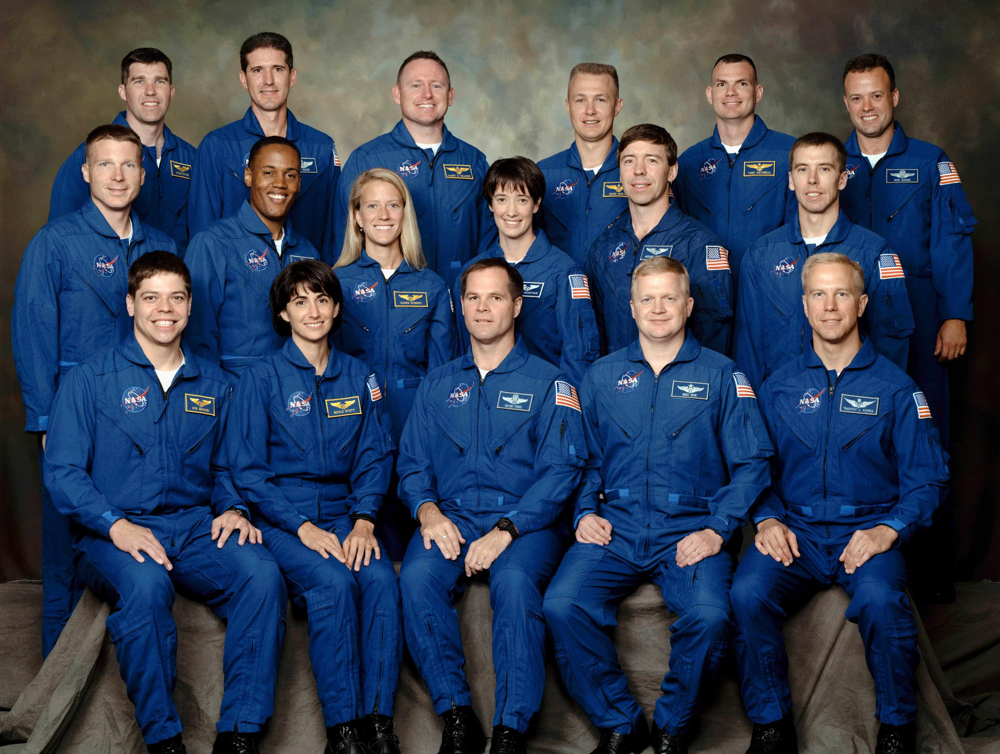

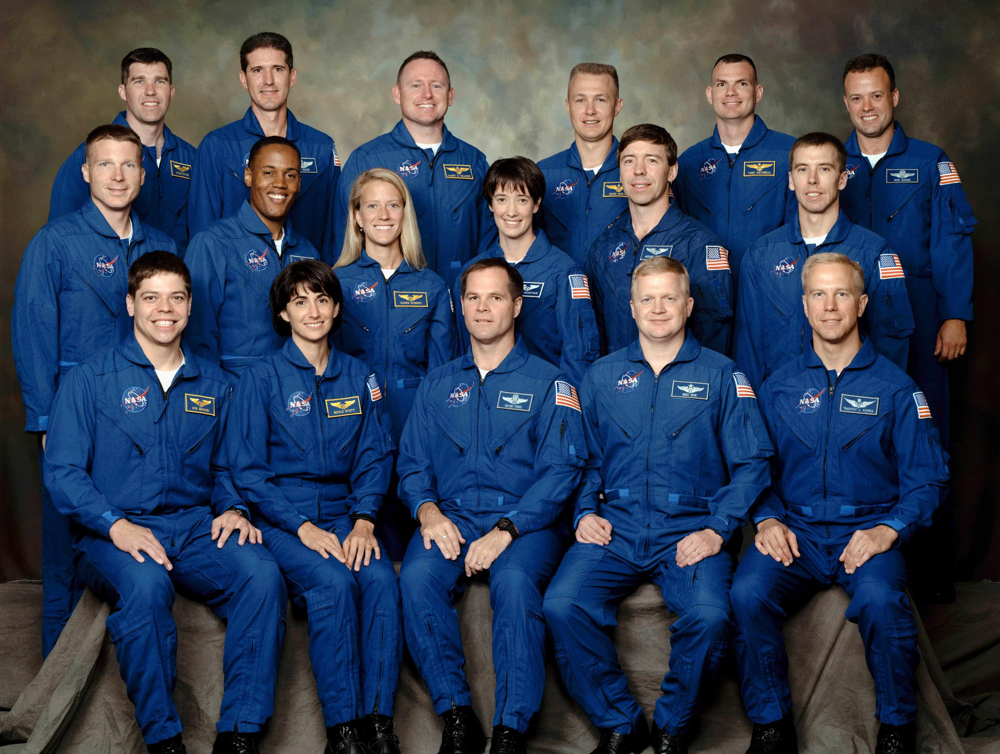

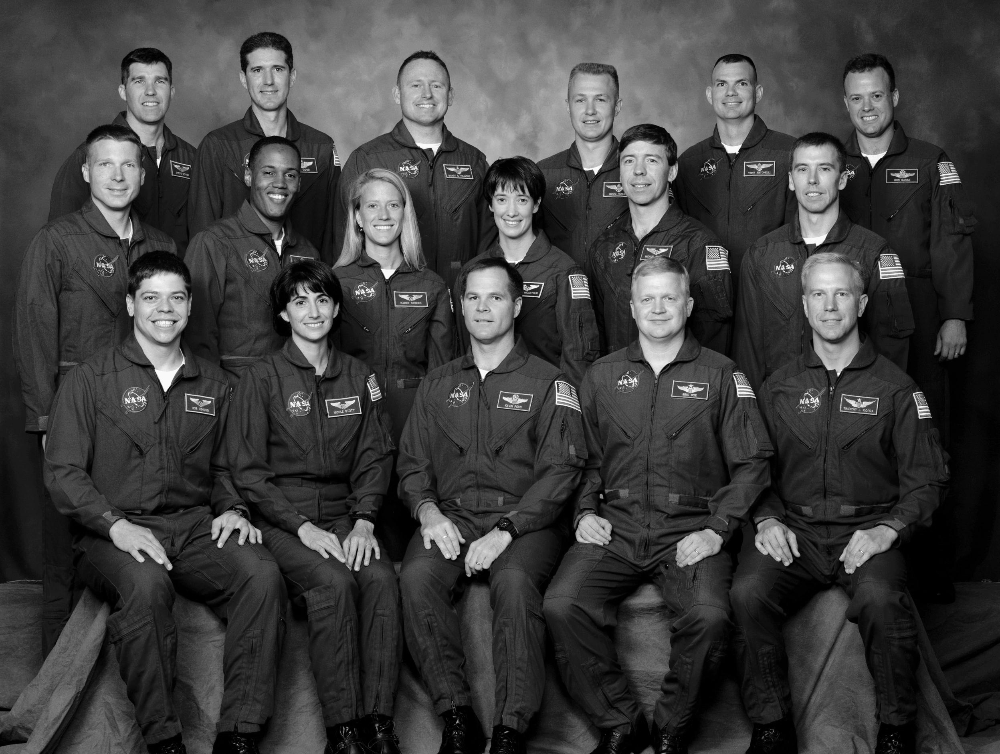

In [ ]:
# Import some Libs
import cv2
# Import Image From Drive And Show Some Detailesabout.
from google.colab import drive 
drive.mount('/content/drive')
image = cv2.imread('/content/peoble_faceDetection_example.png')
image.shape
# Note: cv2.imshow(image) 'when you use with other compiler'
from google.colab.patches import cv2_imshow
cv2_imshow(image)
# Resize The Image to reduse the time and Complexity
#image = cv2.resize(image,(1000,800))
#image.shape
from google.colab.patches import cv2_imshow
cv2_imshow(image)
# Convert Image To Gray Scale To Make It Easy To Apply HaarCascade Algorithem As We Obtained.
image_gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
cv2_imshow(image_gray)

Number Of Eyes =  34


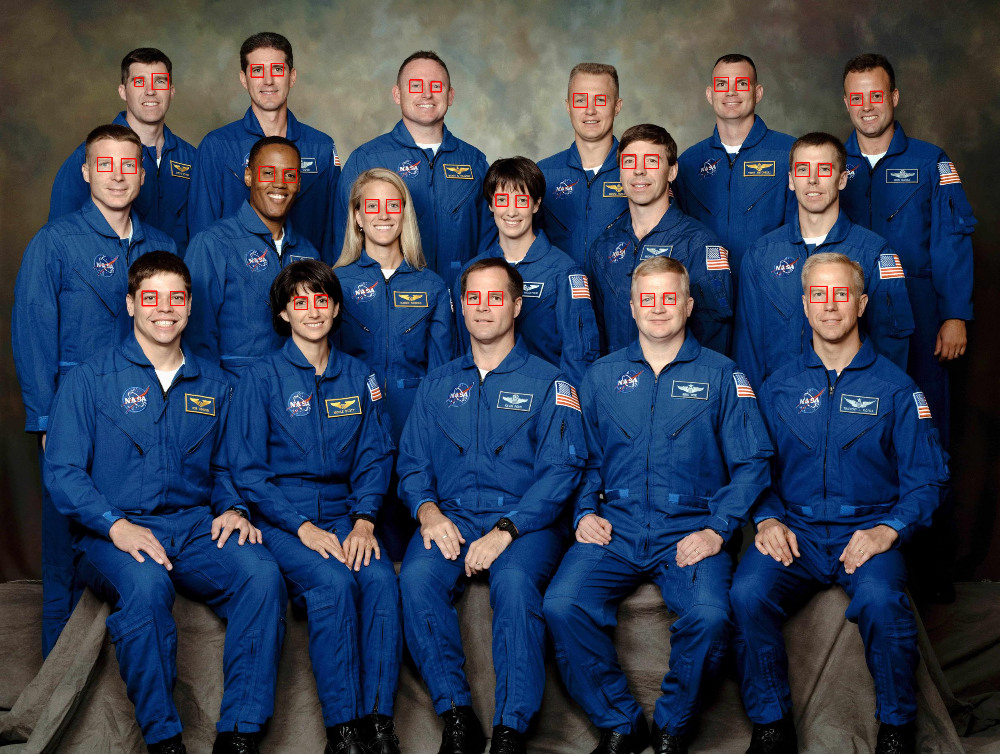

In [ ]:
eyeDetector = cv2.CascadeClassifier("/content/haarcascade_eye.xml")
detections = eyeDetector.detectMultiScale(image_gray,scaleFactor =1.2,minNeighbors=5,maxSize=(50,50))
#detections
print ("Number Of Eyes = ",len(detections))
tempImageForEye = image.copy()
for (x,y,w,h) in detections:
  #print(x,y,w,h)
  cv2.rectangle(tempImageForEye,(x,y),(x+w,y+h),(0,0,255),2)
cv2_imshow(tempImageForEye)

In [ ]:
2*17


34

##**Front Face** Detection using HOG and Dlib.

In [ ]:
import dlib
import  cv2

In [ ]:
from google.colab import drive 
drive.mount('/content/drive')
image = cv2.imread('/content/peoble_faceDetection_example.png')
image.shape
from google.colab.patches import cv2_imshow
cv2_imshow(image)


In [ ]:
faceDetectorHog = dlib.get_frontal_face_detector()
detections = faceDetectorHog(image,1)
print(len(detections))

In [ ]:
for face in detections:
  l,t,r,b = face.left(),face.top(),face.right(),face.bottom()
  print(l,t,r,b)
  cv2.rectangle(image,(l,t),(r,b),(0,255,255),2)

cv2_imshow(image)

##Front Face detection with **CNN** and **Dlib**

In [ ]:
import dlib
import  cv2

In [ ]:
from google.colab import drive 
drive.mount('/content/drive')
image = cv2.imread('/content/peoble_faceDetection_example.png')
image.shape
from google.colab.patches import cv2_imshow
cv2_imshow(image)


In [ ]:
faceDetectorCNN = dlib.cnn_face_detection_model_v1("/content/mmod_human_face_detector.dat")
detections = faceDetectorCNN(image,1)
print(len(detections))

17


In [ ]:
for face in detections:
  l,t,r,b,c = face.rect.left(),face.rect.top(),face.rect.right(),face.rect.bottom(),face.confidence
  print(c)
  cv2.rectangle(image,(l,t),(r,b),(255,255,0),4)

cv2_imshow(image)